In [3]:
# 제주도의 성별 데이터
import csv
f = open('data\\gender.csv')
data = csv.reader(f)
m = []
f = []

In [4]:
name = input('궁금한 동네를 입력하세요: ')
for row in data:
    if name in row[0]:
        for i in range(3,104):
            m.append(int(row[i]))
            f.append(int(row[i+103]))
        break

궁금한 동네를 입력하세요:  종로


ValueError: invalid literal for int() with base 10: '1,107'

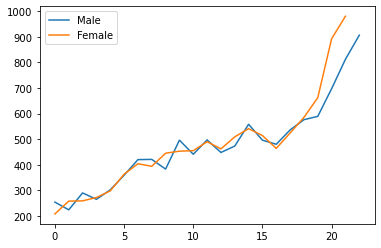

In [5]:
import matplotlib.pyplot as plt
plt.plot(m, label='Male')
plt.plot(f, label='Female')
plt.legend()
plt.show()

In [6]:
# 막대 그래프로 표현하기
import csv
f = open('data\\gender.csv')
data = csv.reader(f)
result=[]
name = input('동네 입력: ')
for row in data:
    if name in row[0]:
        for i in range(3,104):
            result.append(int(row[i])-int(row[i+103]))
        break

동네 입력:  wpwn


ValueError: shape mismatch: objects cannot be broadcast to a single shape

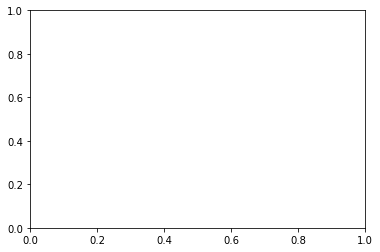

In [7]:
import matplotlib.pyplot as plt
plt.bar(range(101),result)
plt.show()

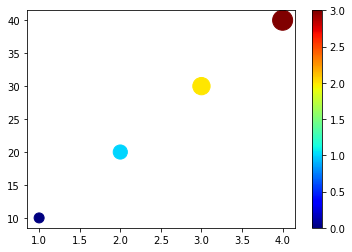

In [12]:
# 산점도로 표현하기 : scatter(x축, y축, s=[점의 크기], c=점의 색깔)
plt.scatter([1,2,3,4],[10,20,30,40], s=[100,200,300,400], c=range(4), cmap='jet')
plt.colorbar()
plt.show()



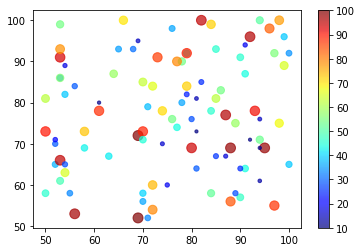

In [16]:
import matplotlib.pyplot as plt
import random

x = []
y = []
size = []

for i in range(100):
    x.append(random.randint(50,100))
    y.append(random.randint(50,100))
    size.append(random.randint(10,100))

plt.scatter(x,y,s=size, c= size, cmap='jet', alpha=0.7)
plt.colorbar()
plt.show()

In [20]:
import csv

f=open('data/subwayfee.csv')
data = csv.reader(f)
next(data)

mx = 0
rate = 0
mx_station=''

for row in data:
    for i in range(4,8):
        row[i] = int(row[i])
    if row[6] != 0 and (row[4]+row[6])>100000:
        rate = row[4]/(row[4]+row[6])
        if rate > mx:
            mx = rate
            mx_station = row[3]+ ' ' + row[1]

print(mx_station, round(mx*100,2))


홍대입구 2호선 95.34


In [21]:
import csv

f=open('data/subwayfee.csv')
data = csv.reader(f)
next(data)

mx = [0] * 4
mx_station = ['']*4
label = ['유임승차', '유임하차', '무임승차', '무임하차']
for row in data:
    for i in range(4,8):
        row[i] = int(row[i])
        if row[i] > mx[i-4]:
            mx[i-4] = row[i]
            mx_station[i-4] = row[3] + ' ' + row[1]

for i in range(4):
    print(label[i]+' : '+mx_station[i], mx[i])
    

유임승차 : 강남 2호선 3153418
유임하차 : 강남 2호선 3210437
무임승차 : 종로3가 1호선 387062
무임하차 : 제기동 1호선 400607


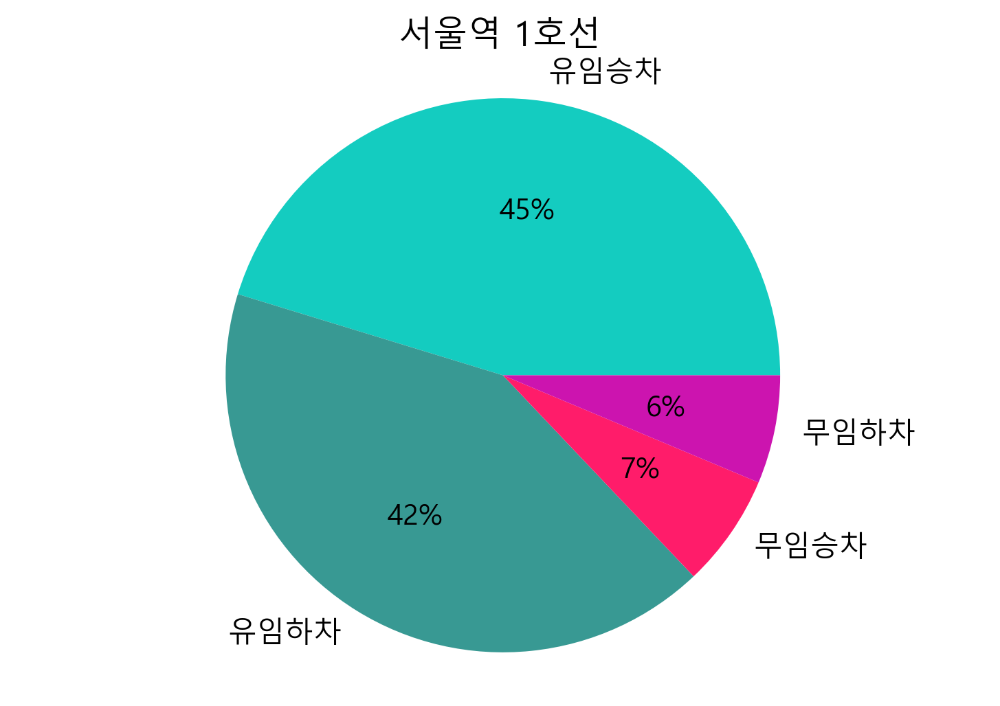

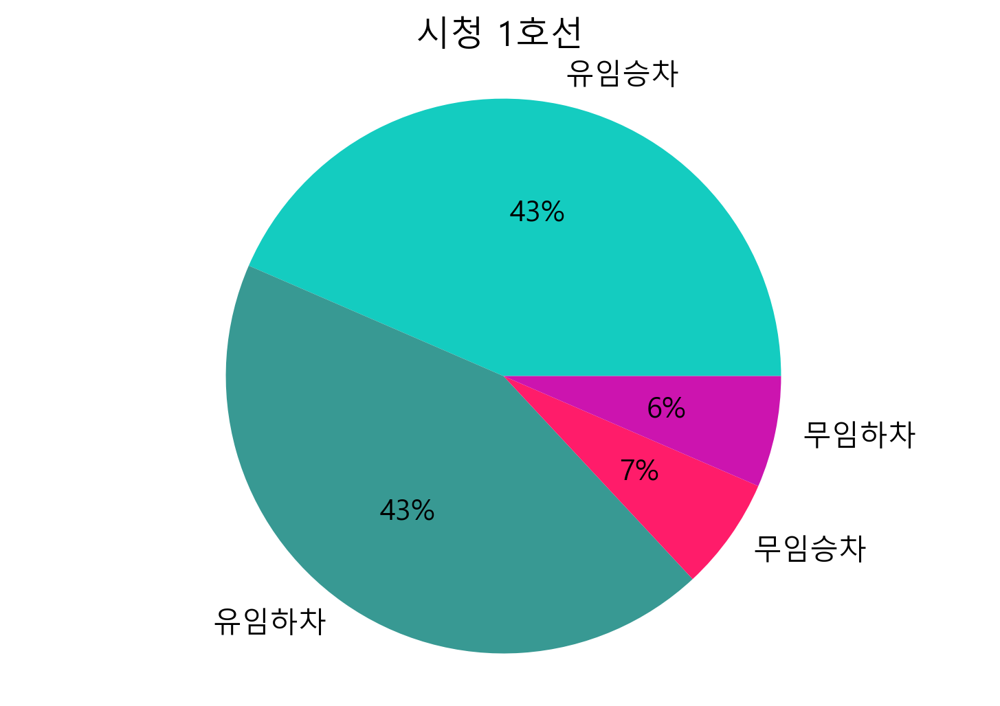

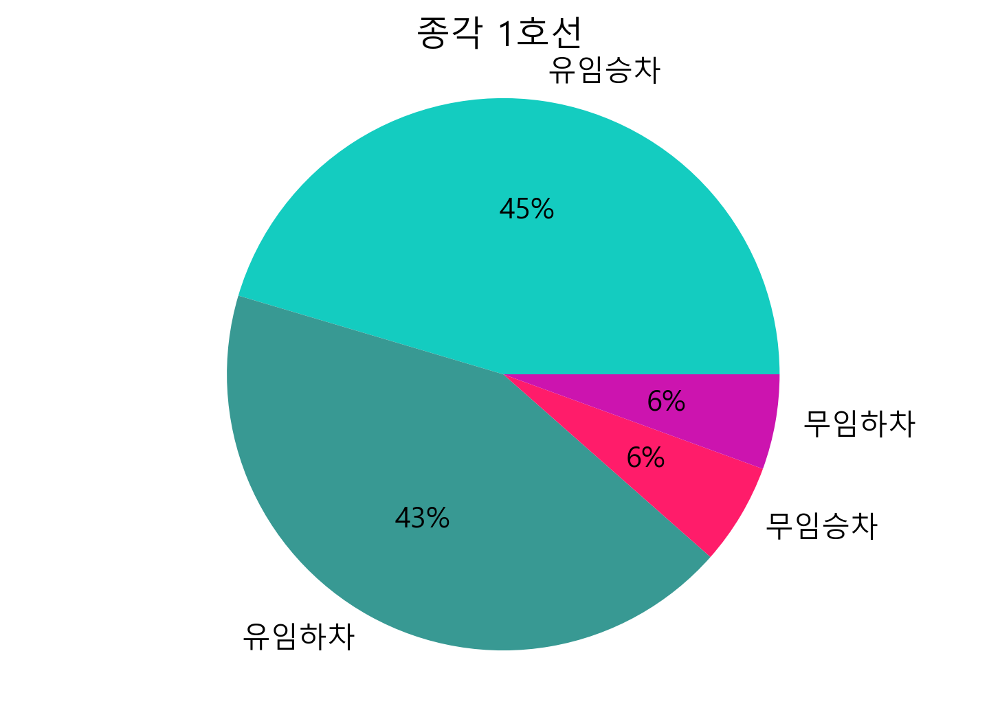

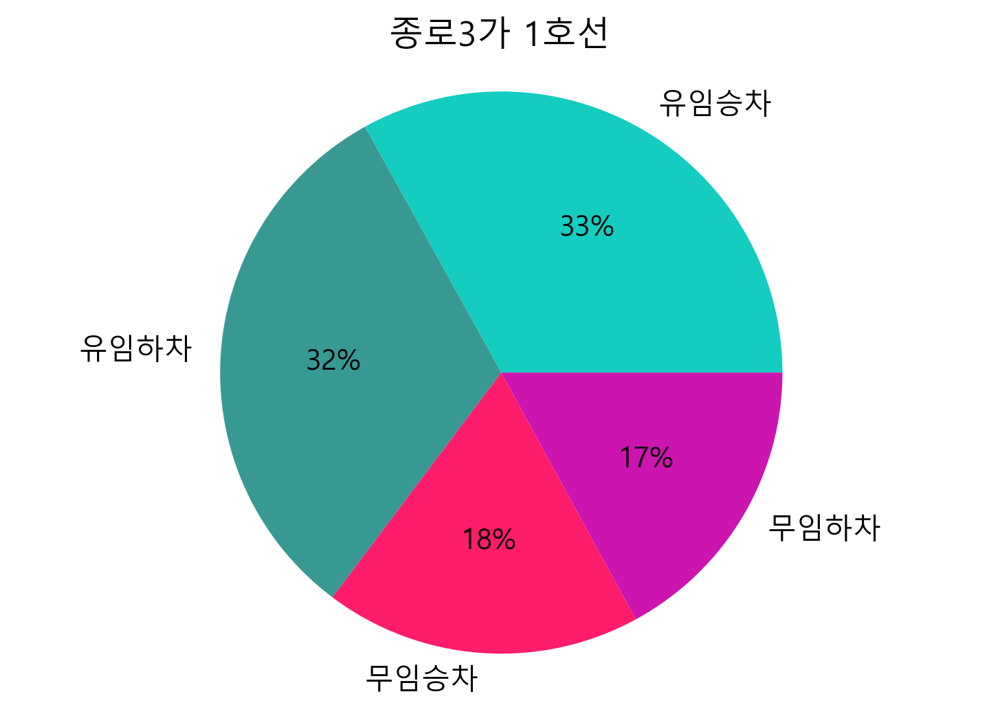

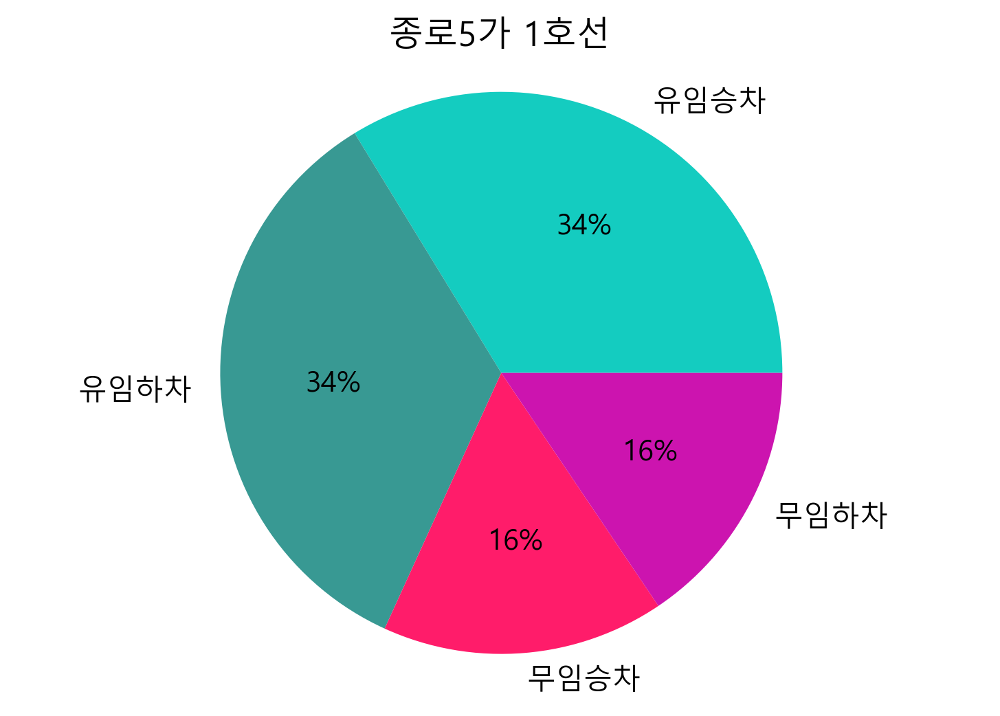

...

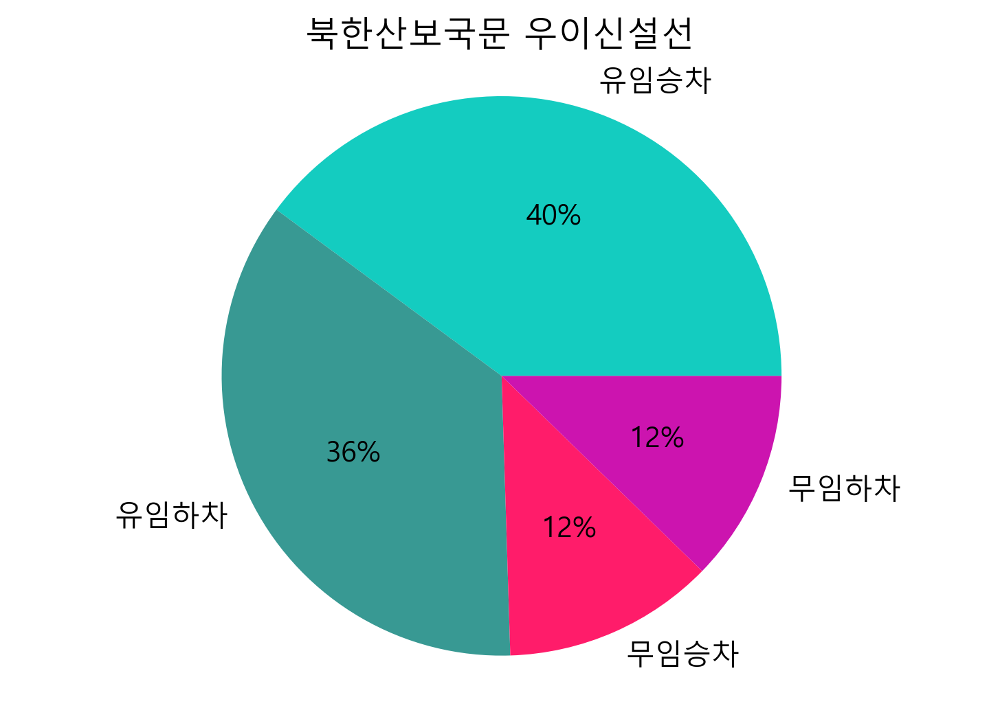

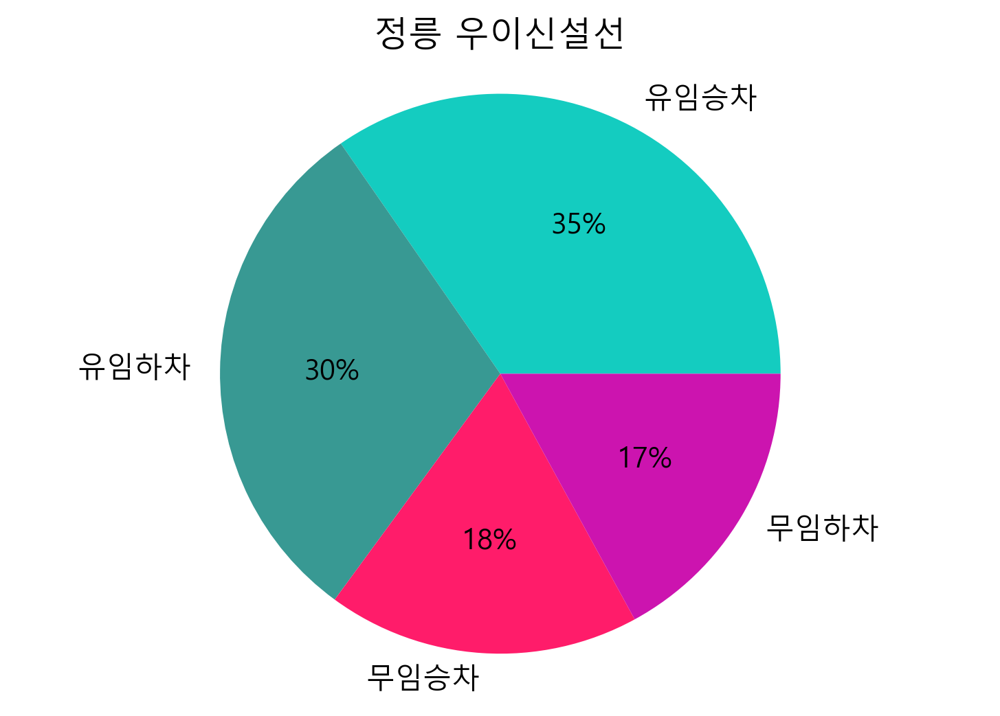

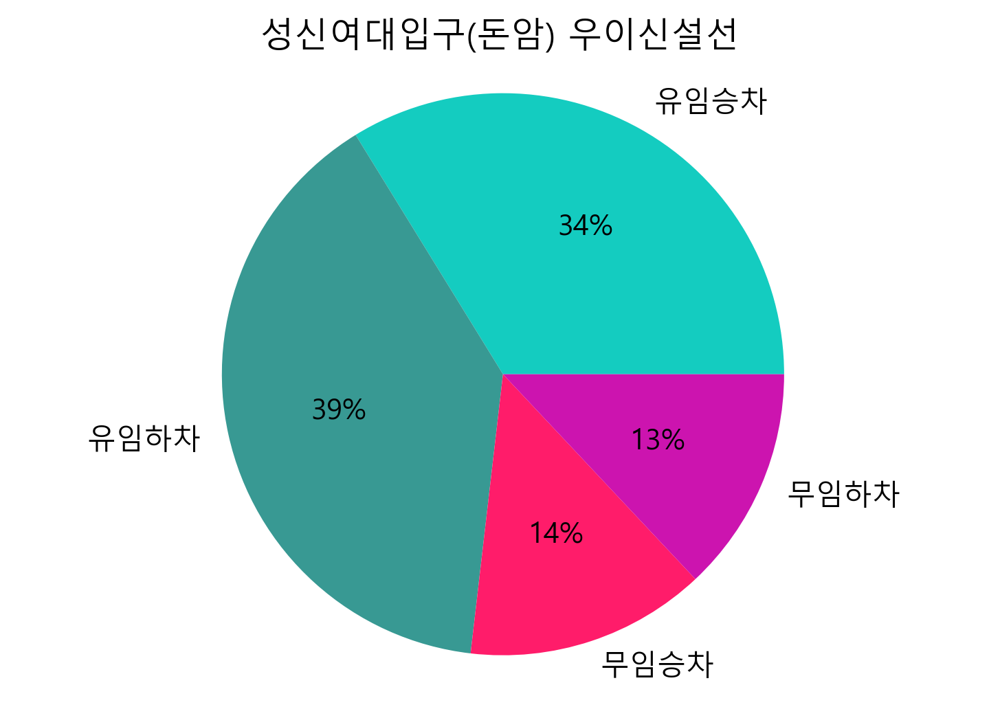

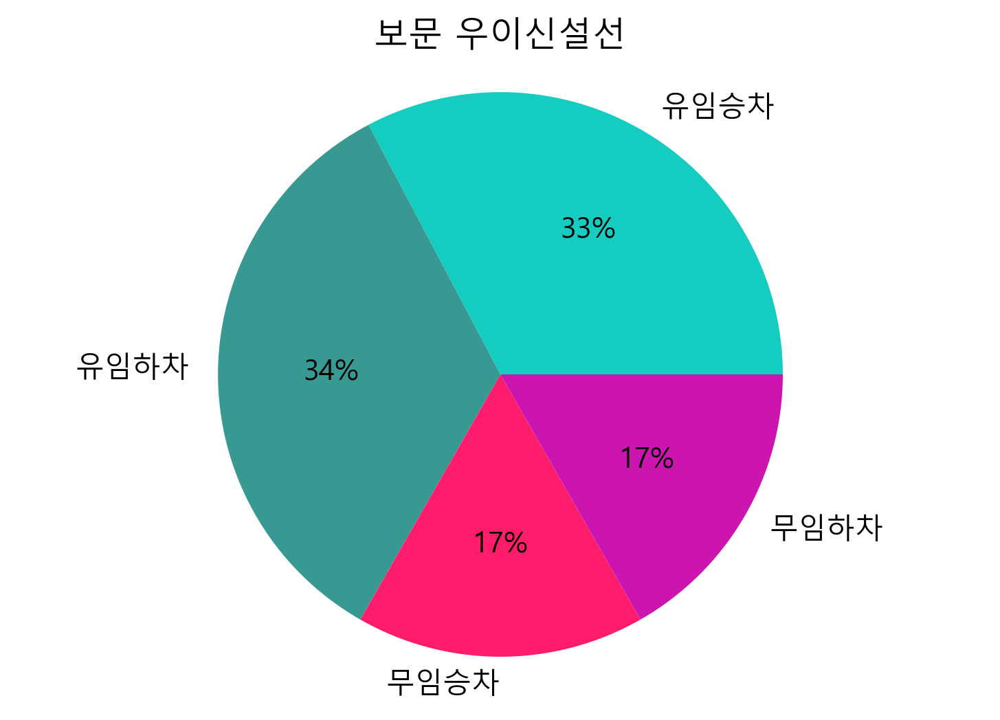

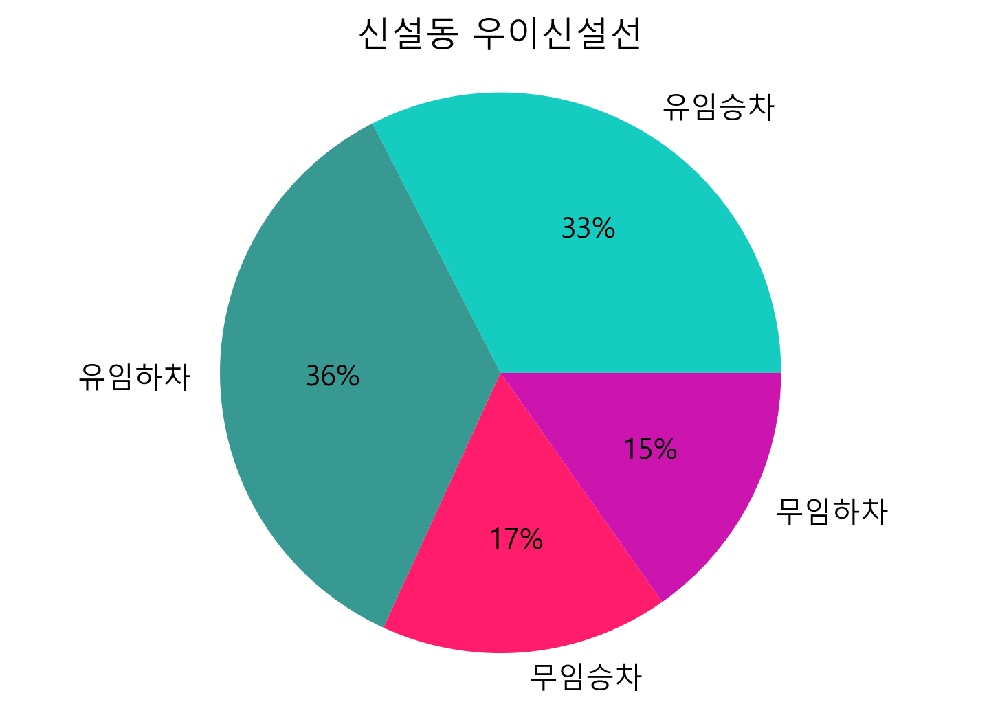

In [22]:
#모든 역의 유무임 승하차 비율 파이 차트로 나타내기
import csv

f=open('data/subwayfee.csv')
data = csv.reader(f)
next(data)
label = ['유임승차', '유임하차', '무임승차', '무임하차']
c = ['#14CCC0','#389993','#FF1C6A','#CC14AF']
plt.rc('font', family='Malgun Gothic')

for row in data:
    for i in range(4,8):
        row[i] = int(row[i])
    plt.figure(dpi=300)
    plt.title(row[3]+ ' ' + row[1])
    plt.pie(row[4:8], labels=label, colors = c, autopct='%1.f%%')
    plt.axis('equal')
    #plt.savefig(row[3] + ' '+row[1]+'.png')
    plt.show()

In [6]:
#출근 시간대 사람들이 가장 많이 타고 내리는 역
import csv
f = open('data/subwaytime.csv', encoding='utf-8')
data = csv.reader(f)
next(data)
next(data)
mx=0
mx_station = ''
for row in data:
    row[4:] = map(int, row[4:])
    a = row[11:16:2]
    if sum(a)>mx:
        mx=sum(a)
        mx_station = row[3] + '(' + row[1] + ')'
print(mx_station, mx)

TypeError: unsupported operand type(s) for +: 'int' and 'str'

In [9]:
#밤 11시 사람들이 가장 많이 타는 역
import csv
f = open('data/subwaytime.csv', encoding='utf-8')
data = csv.reader(f)
next(data)
next(data)
mx = 0
mx_station = ''

t= int(input("몇시의 승차인원이 가장 많은 역이 궁금하세요?"))

for row in data:
    row[4:] = map(int, row[4:])
    a = row[4+(t-4)*2]
    if a> mx:
        mx=a
        mx_station = row[3] + '(' + row[1] + ')'

print(mx_station, mx)

몇시의 승차인원이 가장 많은 역이 궁금하세요? s


ValueError: invalid literal for int() with base 10: 's'

In [11]:
#시간대별 하차 인원이 가장 많은 역
import csv
f = open('data/subwaytime.csv', encoding='utf-8')
data = csv.reader(f)
next(data)
next(data)
mx = [0]*24
mx_station = ['']*24

for row in data:
    row[4:] = map(float, row[4:])
    for j in range(24):
        b = row[5+j*2]
        if b>mx[j]:
            mx[j] = b
            mx_station[j] = row[3] + '(' + str(j+4) + ')'
            
plt.rc('font', family='Malgun Gothic')
plt.bar(range(24), mx, color='b')
plt.xticks(range(24),mx_station, rotation=90)
plt.show()


ValueError: could not convert string to float: '10,682'

In [12]:
#지하철 시간대별 승하차 인원 추이를 나타내는 코드
import csv
import matplotlib.pyplot as plt

f = open('data/subwaytime.csv', encoding='utf-8')
data = csv.reader(f)
next(data)
next(data)

s_in = [0]*24
s_out = [0]*24

for row in data:
    row[4:] = map(int, row[4:])
    for i in range(24):
        s_in += row[4+i*2]
        s_out += row[5+i*2]
        
plt.rc('font', family = 'Malgun Gothic')
plt.title("지하철 시간대별 승하차 인원 추이")
plt.plot(s_in, label='승차')
plt.plot(s_out, label='하차')
plt.legend()
plt.xticks(range(24), range(4,28))
plt.show()

ValueError: invalid literal for int() with base 10: '10,682'